# Requirements to collpase requirements tables Note + Making Concordances Concord - Tony Gui

In [1]:
import pandas as pd
import numpy as np
from dotenv import dotenv_values, find_dotenv
from statsmodels.tsa.api import VAR
import os
import re
from data_cleaning_functions import requirements_clean, concordance_PCE_clean, \
    find_intermediate_industries, concordance_PCQ_clean, get_sales_from_make_matrix, clean_make_matrix, \
    get_demand_shock_from_shaipro_output, get_expenditure_weights_from_shapiro_outputs,plot_shapiro_graph_from_shapiro_ouput,clean_bea_PQE_table

from pathlib import Path
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore', category=FutureWarning, message=".*concatenation with empty or all-NA entries is deprecated.*")

script_dir = str(Path().resolve().parent)
file_path = os.path.join(script_dir) + "/" 
shapiro_file =  file_path + "Shapiro"
raw_data_path = file_path + "raw_bea_data" 


/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# 1. Load in Requirements Matrix 

In [2]:
requirements = pd.read_excel(os.path.join(raw_data_path, 'IxI_TR_2017_PRO_Det.xlsx'), sheet_name='2017')
requirements = requirements_clean(requirements)
requirements

2,oilseed farming,grain farming,vegetable and melon farming,fruit and tree nut farming,"greenhouse, nursery, and floriculture production",other crop farming,dairy cattle and milk production,"beef cattle ranching and farming, including feedlots and dual-purpose ranching and farming",poultry and egg production,"animal production, except cattle and poultry and eggs",...,federal general government (nondefense),postal service,federal electric utilities,other federal government enterprises,state and local government (educational services),state and local government (hospitals and health services),state and local government (other services),state and local government passenger transit,state and local government electric utilities,other state and local government enterprises
nan,,,,,,,,,,,,,,,,,,,,,
oilseed farming,1.279779,0.014409,0.004929,0.001729,0.001137,0.00316,0.023745,0.01215,0.048375,0.006966,...,-0.000636,0.000089,0.000451,0.002027,0.000422,0.0018,0.000539,0.002588,0.000153,0.000357
grain farming,0.002576,1.160693,0.005144,0.004288,0.002814,0.027177,0.103283,0.116055,0.147067,0.023998,...,0.0003,0.000189,0.00128,0.007513,0.001212,0.004625,0.001335,0.006901,0.000319,0.000772
vegetable and melon farming,0.000224,0.000785,1.037335,0.000679,0.000341,0.000616,0.000247,0.000177,0.000243,0.000105,...,0.000006,0.000004,0.00019,0.000907,0.00014,0.000308,0.000098,0.000019,0.000004,0.000009
fruit and tree nut farming,0.000245,0.000826,0.000647,1.026228,0.000361,0.000646,0.000507,0.000257,0.000495,0.000154,...,0.000032,0.000022,0.000933,0.003551,0.000496,0.002885,0.000562,0.000058,0.000017,0.000033
"greenhouse, nursery, and floriculture production",0.000769,0.002365,0.001809,0.001517,1.152284,0.002257,0.000938,0.000594,0.000857,0.000322,...,0.000109,0.000067,0.000186,0.000286,0.000117,0.000714,0.00162,0.001763,0.000117,0.00025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
state and local government (hospitals and health services),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000051,0.0,0.0,0.000001,0.0,1.000321,0.0,0.0,0.0,0.0
state and local government (other services),0.003345,0.010249,0.007965,0.007278,0.004364,0.008178,0.004048,0.002967,0.003636,0.001896,...,0.001066,0.001097,0.001879,0.002528,0.000768,0.00152,1.003711,0.003982,0.002619,0.002899
state and local government passenger transit,0.00012,0.000219,0.000136,0.000084,0.00011,0.000162,0.000203,0.000135,0.000233,0.000067,...,0.000143,0.000069,0.000191,0.000718,0.002467,0.000231,0.000541,1.008448,0.000119,0.000197


# 2. Calculate Delta

In [3]:
requirements = requirements.T
with pd.option_context("future.no_silent_downcasting", True):
    requirements = requirements.fillna(0).infer_objects(copy=False)
delta = np.identity(len(requirements)) - np.linalg.inv(requirements)

# 2 (Making Concordances Concord) Adding Scrap, Used and secondhand goods and ROW adjustments to Delta

In [4]:
"""These 4 industries are found in the concordance table but not in the Reqirements table so I am 
adding them manually with row and column inputs of zero"""
concordance_but_not_requirments = ["Scrap", "Used and secondhand goods", "Rest of the world adjustment", "noncomparable imports"] 
delta = pd.DataFrame(delta, index=requirements.index, columns=requirements.columns)
delta = delta.reindex(index=requirements.index.append(pd.Index(concordance_but_not_requirments)).str.lower() , columns=requirements.columns.append(pd.Index(concordance_but_not_requirments)).str.lower() , fill_value=0)

delta

,oilseed farming,grain farming,vegetable and melon farming,fruit and tree nut farming,"greenhouse, nursery, and floriculture production",other crop farming,dairy cattle and milk production,"beef cattle ranching and farming, including feedlots and dual-purpose ranching and farming",poultry and egg production,"animal production, except cattle and poultry and eggs",...,state and local government (educational services),state and local government (hospitals and health services),state and local government (other services),state and local government passenger transit,state and local government electric utilities,other state and local government enterprises,scrap,used and secondhand goods,rest of the world adjustment,noncomparable imports
oilseed farming,2.182305e-01,4.406835e-04,1.585737e-04,1.608751e-04,1.585959e-04,4.303772e-03,3.059061e-04,1.258588e-03,5.658938e-04,6.267435e-04,...,0.000001,2.648539e-09,0.001996,1.269964e-06,0.000556,0.012915,0.0,0.0,0.0,0.0
grain farming,8.699834e-03,1.346781e-01,6.322803e-04,6.412868e-04,6.323431e-04,8.904588e-03,1.219444e-03,5.363358e-03,1.138804e-03,3.121992e-03,...,0.000004,6.914341e-09,0.007465,2.999316e-06,0.000490,0.028099,0.0,0.0,0.0,0.0
vegetable and melon farming,2.879852e-03,1.566776e-03,3.597787e-02,5.720080e-04,5.639853e-04,4.426647e-04,1.087635e-03,2.470001e-03,1.015753e-03,1.101832e-03,...,0.000002,1.644074e-08,0.006705,5.462029e-07,0.002355,0.028720,0.0,0.0,0.0,0.0
fruit and tree nut farming,7.340969e-04,1.550789e-03,6.284265e-04,2.553083e-02,5.581646e-04,4.351929e-04,1.076470e-03,3.931517e-03,1.005375e-03,1.872118e-03,...,0.000001,-6.199510e-09,0.006478,1.658714e-07,0.001537,0.020232,0.0,0.0,0.0,0.0
"greenhouse, nursery, and floriculture production",3.650259e-04,7.710037e-04,2.774939e-04,2.815021e-04,1.316849e-01,2.236586e-04,5.352380e-04,1.699724e-03,4.998527e-04,7.544837e-04,...,0.000001,-4.228297e-08,0.003166,2.865100e-07,0.000520,0.004565,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
other state and local government enterprises,7.913078e-09,4.430928e-08,3.368415e-08,5.390985e-08,1.475397e-08,-2.887312e-09,4.936176e-09,3.347282e-08,3.480128e-09,5.309115e-08,...,0.000009,-8.258717e-09,0.001245,1.538235e-05,0.000459,0.007313,0.0,0.0,0.0,0.0
scrap,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.0,0.0,0.0,0.0
used and secondhand goods,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.0,0.0,0.0,0.0
rest of the world adjustment,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.0,0.0,0.0,0.0


# 2.5b Making Negative Values in Delta Zero

In [5]:
negative_count = (delta < 0).sum().sum()
x = negative_count/402**2
delta[delta < 0] = 0
negative_count_new = (delta < 0).sum().sum()
y = negative_count_new/402**2

# 2.5b Force negatives to be zero but adjust row sums to be same as before

In [6]:
# V = delta.sum(axis=0)
# P = delta[delta > 0].sum()
# delta.loc['norm'] = V/P
# last_values = delta.iloc[-1]
# delta[delta < 0] = 0
# delta = delta.iloc[:-1].div(last_values)
# delta

# Dealting with Intermediate Industries - Making Concordances Concord Section 3.3.1. - Operationalizing Industries without Products

# Step 1. Making Concordances Concord

In [7]:
use_table = pd.read_excel(os.path.join(raw_data_path, "Use_SUT_Framework_2017_DET.xlsx"), sheet_name="2017")
# peq_concordance = pd.read_excel(os.path.join(raw_data_path, "PEQBridge_2017_DET.xlsx"), sheet_name="2017")

# Returns all industries with zero PCE 
intermediate_industries = find_intermediate_industries(use_table)

# peq_concordance = concordance_PCQ_clean(peq_concordance)
# intermediate_industries = intermediate_industries[~intermediate_industries['Industry'].isin(peq_concordance['Industries'])]

intermediate_industries = intermediate_industries.iloc[:, [0]]
intermediate_industries = intermediate_industries.sort_values(by="Industry")
intermediate_industries

,Industry
106,air and gas compressor manufacturing
163,aircraft engine and engine parts manufacturing
67,"all other forging, stamping, and sintering"
344,"all other miscellaneous professional, scientif..."
291,all other retail
...,...
81,valve and fittings other than plumbing
42,"veneer, plywood, and engineered wood product m..."
281,wholesale electronic markets and agents and br...
145,wiring device manufacturing


# Steps 2 - 5. Making Concordances Concord - Loop over Intermediate Industries and Remove

In [8]:
# requirements = pd.read_excel(os.path.join(raw_data_path, 'IxI_TR_2017_PRO_Det.xlsx'), sheet_name='2017')
# requirements = requirements_clean(requirements, wide=True)

# For the Loop 
big_lambda = np.eye(len(delta)) # create a big_lambda identity matrix that will become out final output
big_lambda = pd.DataFrame(big_lambda)
big_lambda = big_lambda.set_index(delta.index)
big_lambda.columns = delta.index
delta_industries = delta.index # save all the requirment table industries outside the loop 
removed = [] # stores all removed industries through the loop 

i = 0
for row in intermediate_industries.iloc[::-1].itertuples(): # looping backwards
    i += 1 
    current = row.Industry # industry we are currently removing
    # Create identity matrix for current loop iteration
    phi_i = np.eye(len(delta) - (i - 1))
    phi_i = pd.DataFrame(phi_i)
    phi_i = phi_i.set_index(delta_industries)
    phi_i.columns = delta_industries

    current_intermediate_use_table = delta.copy() # use a new intermediates use matrix each time we do this
    # Remove all the industries we've previously removed in earlier loop iterations 
    current_intermediate_use_table.drop(columns=removed, inplace=True)
    current_intermediate_use_table = current_intermediate_use_table.loc[[current]] # the row of the intermediates use table associated with the current industry  
    current_intermediate_use_table.drop(columns=[current], inplace=True) # drop the column associated with the current industry so we dont include it in our sum
    current_intermediate_use_table = current_intermediate_use_table.astype(float)
    current_industry_sum = current_intermediate_use_table.loc[current].sum() # find sum of row

    # just making sure that we aren't dividing by zero 
    if current_industry_sum != 0:
        current_intermediate_use_table = current_intermediate_use_table.astype(float)
        current_intermediate_use_table.loc[current] = current_intermediate_use_table.loc[current] / current_industry_sum


    current_intermediate_use_table = current_intermediate_use_table[sorted(current_intermediate_use_table.columns)] # sort the normazlied row alphabetically

    # remove the current industry from intermediate list
    intermediate_industries = intermediate_industries[intermediate_industries['Industry'] != current]
    # drop the current industry column from phi_i and industry indexing
    phi_i = phi_i.drop(columns=current)
    delta_industries = delta_industries.drop(current) 
    
    removed.append(current)

    # Update phi_i with the current industry sale shares
    phi_i.loc[current_intermediate_use_table.index] = current_intermediate_use_table.loc[current_intermediate_use_table.index].astype(np.float64).values
    big_lambda_old = big_lambda
    big_lambda = big_lambda @ phi_i

# Step 6. Making Concordances Concord - Converting IO matrix from sales shares to dollars

In [9]:
make_matrix = pd.read_excel(os.path.join(raw_data_path, "Supply_2017_DET.xlsx"), sheet_name="2017")
sales_vector = get_sales_from_make_matrix(make_matrix) # returns the sales for each industry

# these industries are not in the make matrix so i will add them manually with zero entries to preserve df sizes
industries_not_in_make_matrix = ["state and local government passenger transit", "state and local government electric utilities", \
                      "secondary smelting and alloying of aluminum", "federal electric utilities"]
not_in_make_matrix = pd.DataFrame({'Industries': industries_not_in_make_matrix, 'Sales': [0,0,0,0]})
sales_vector = pd.concat([sales_vector, not_in_make_matrix], ignore_index=True)
sales_vector.set_index('Industries', inplace=True)

# repeat the sales vector n times to make a sales matrix
sales_repeated = pd.DataFrame({f'{i}': sales_vector['Sales'].values for i in range(1, len(delta))})
sales_repeated.set_index(sales_vector.index, inplace=True)
sales_matrix = pd.concat([sales_vector, sales_repeated], axis=1)
sales_matrix.columns = delta.columns

# Y is IO matrix in dollars 
Y = delta * sales_matrix 
Y

,oilseed farming,grain farming,vegetable and melon farming,fruit and tree nut farming,"greenhouse, nursery, and floriculture production",other crop farming,dairy cattle and milk production,"beef cattle ranching and farming, including feedlots and dual-purpose ranching and farming",poultry and egg production,"animal production, except cattle and poultry and eggs",...,state and local government (educational services),state and local government (hospitals and health services),state and local government (other services),state and local government passenger transit,state and local government electric utilities,other state and local government enterprises,scrap,used and secondhand goods,rest of the world adjustment,noncomparable imports
abrasive product manufacturing,0.000173,0.000391,0.000304,0.000108,0.000253,0.000048,0.000267,0.000359,0.000159,0.000300,...,0.000000,0.000000,0.426337,0.172122,8.636189,4.932733,0.0,0.0,0.0,0.0
accommodation,0.191396,7.116882,3.028562,10.755501,0.228335,0.398835,0.285496,0.408856,15.305094,3.152467,...,1.134877,0.009828,144.634216,14.918320,903.349215,1297.444393,0.0,0.0,0.0,0.0
"accounting, tax preparation, bookkeeping, and payroll services",0.101899,0.220845,0.069017,0.073229,10.303120,0.059961,0.145954,0.214379,0.146801,0.089105,...,0.562043,0.000000,59.049672,85.138917,57.336309,295.747101,0.0,0.0,0.0,0.0
adhesive manufacturing,0.000000,0.000075,0.000000,0.000125,0.000894,1.370239,0.000315,0.000295,0.000973,0.100457,...,0.000020,0.000069,2.782922,0.355148,15.811327,28.744208,0.0,0.0,0.0,0.0
"advertising, public relations, and related services",0.118975,0.231499,0.079510,0.093259,60.701496,0.090857,0.176306,0.248775,0.149080,0.100195,...,1.343385,0.000000,68.774605,91.764284,178.940281,460.014726,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
wineries,0.000234,0.001948,0.001074,3748.770641,0.000730,0.022858,0.000019,0.001052,0.000358,0.000000,...,0.000000,0.000000,1.714720,0.703128,12.761989,21.467078,0.0,0.0,0.0,0.0
wired telecommunications carriers,0.000000,0.017611,0.004495,0.007220,0.007071,0.000000,0.013855,0.023191,0.025616,0.006452,...,3.885719,0.000000,27.578492,9.743359,378.965445,138.178749,0.0,0.0,0.0,0.0
wireless telecommunications carriers (except satellite),0.038704,0.061536,0.031261,0.017260,0.030407,0.042745,0.048435,0.057570,0.040641,0.029312,...,3.728915,0.009751,33.764658,72.612508,124.071708,249.119748,0.0,0.0,0.0,0.0
wiring device manufacturing,0.000000,0.000078,0.000000,0.000000,0.000286,0.000265,0.000463,0.000000,0.000000,0.000000,...,0.000063,0.000000,1.057741,0.218592,12.107064,6.265271,0.0,0.0,0.0,0.0


# Step 7. Making Concordances Concord - Value Added for the Economy

In [10]:
sum_Y = Y.sum(axis=1).to_frame()
sum_Y.columns = ['Sales']
VA_pre_transformation = (sales_vector - sum_Y).sum()

VA_pre_transformation

Sales    1.946673e+07
dtype: float64

# Step 8. Making Concordances Concord - IO Matrix in USD

In [11]:
# new IO matrix in USD 
Y_tilde = big_lambda.T @ Y @ big_lambda
sales_tilde = big_lambda.T @ sales_vector

# Verifing that economy wide value added is identical to the pre-transformation level
sum_Y_tilde = Y_tilde.sum(axis=1).to_frame()
sum_Y_tilde.columns = ['Sales']
VA_post_transformation = (sales_tilde - sum_Y_tilde).sum()
VA_post_transformation

Sales    1.946579e+07
dtype: float64

In [12]:
"""Pre transformation and post transformation are not the same"""

differnece = VA_post_transformation - VA_pre_transformation
differnece

Sales   -938.752332
dtype: float64

# Step 9. Making Concordances Concord - Calculating New Delta

In [13]:
recip_sales = 1/sales_tilde
sales_tilde_repeated = pd.DataFrame({f'{i}': recip_sales['Sales'].values for i in range(1, len(delta))})
sales_tilde_repeated.set_index(recip_sales.index, inplace=True)
sales_tilde_matrix = pd.concat([recip_sales, sales_tilde_repeated], axis=1)
sales_tilde_matrix.columns = delta.columns

delta_tilde = Y_tilde * sales_tilde_matrix
delta = delta_tilde
delta

,abrasive product manufacturing,accommodation,"accounting, tax preparation, bookkeeping, and payroll services",adhesive manufacturing,"advertising, public relations, and related services",air and gas compressor manufacturing,"air conditioning, refrigeration, and warm air heating equipment manufacturing",air transportation,aircraft engine and engine parts manufacturing,aircraft manufacturing,...,"watch, clock, and other measuring and controlling device manufacturing",water transportation,"water, sewage and other systems",wet corn milling,wholesale electronic markets and agents and brokers,wineries,wired telecommunications carriers,wireless telecommunications carriers (except satellite),wiring device manufacturing,wood kitchen cabinet and countertop manufacturing
grain farming,0.001345,0.001055,0.003757,0.000586,0.002082,NaN,0.000617,0.005235,NaN,0.000523,...,0.000382,0.004111,0.003510,0.000432,NaN,0.000180,0.010638,0.002581,NaN,NaN
vegetable and melon farming,0.001237,0.003106,0.005549,0.000527,0.003991,NaN,0.000803,0.005990,NaN,0.002759,...,0.000550,0.001436,0.001074,0.000686,NaN,0.000154,0.005156,0.005109,NaN,NaN
fruit and tree nut farming,0.001126,0.001616,0.006718,0.000745,0.005173,NaN,0.000901,0.004425,NaN,0.000744,...,0.000334,0.001244,0.000770,0.000645,NaN,0.000164,0.003187,0.002907,NaN,NaN
"greenhouse, nursery, and floriculture production",0.001245,0.000836,0.005241,0.000951,0.004542,NaN,0.000934,0.003375,NaN,0.000619,...,0.000386,0.002597,0.000496,0.000804,NaN,0.000208,0.005707,0.003396,NaN,NaN
other crop farming,0.001188,0.001441,0.006109,0.000647,0.008079,NaN,0.000728,0.003973,NaN,0.001428,...,0.000316,0.001386,0.001028,0.000652,NaN,0.000155,0.004018,0.002966,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
other state and local government enterprises,0.001137,0.000637,0.006257,0.000474,0.001883,NaN,0.000927,0.002730,NaN,0.000990,...,0.000784,0.000833,0.000699,0.001347,NaN,0.000426,0.003870,0.002827,NaN,NaN
scrap,0.000237,0.000157,0.000845,0.000178,0.000769,NaN,0.000151,0.000410,NaN,0.000115,...,0.000060,0.000239,0.000075,0.000345,NaN,0.000061,0.000860,0.000583,NaN,NaN
used and secondhand goods,0.001423,0.001650,0.005193,0.002081,0.001946,NaN,0.000731,0.003871,NaN,0.001008,...,0.000295,0.002290,0.000615,0.000631,NaN,0.000311,0.011219,0.008206,NaN,NaN
rest of the world adjustment,0.000867,0.001482,0.004251,0.000501,0.002892,NaN,0.000933,0.003412,NaN,0.001531,...,0.000364,0.001321,0.000500,0.000576,NaN,0.000146,0.009108,0.006423,NaN,NaN


# End of Making Concordances Concord - Back to Requirements to Collapse Requirements Table

# 3. Merge Concordance with Delta

In [14]:
concordance = pd.read_excel(os.path.join(raw_data_path, "PCEBridge_2017_DET.xlsx"), sheet_name="2017")
concordance = concordance_PCE_clean(concordance)
concordance

,PCE Bridge Products,PCE Bridge Industries
0,new domestic autos,automobile manufacturing
1,new domestic autos,motor vehicle body manufacturing
2,new foreign autos,automobile manufacturing
3,new light trucks,light truck and utility vehicle manufacturing
4,used autos,scrap
...,...,...
700,final consumption expenditures of nonprofit in...,religious organizations
701,final consumption expenditures of nonprofit in...,"grantmaking, giving, and social advocacy organ..."
702,final consumption expenditures of nonprofit in...,"civic, social, professional, and similar organ..."
703,tenant-occupied stationary homes,tenant-occupied housing


In [15]:
"""the problem here is some industries in the requirments matrix still have no match to PCE they are matching to PEQ so i must drop them here when im trying to 
make the requirments table in terms of products however im not sure if this changes some of the math performed to the requirments matrix ie delta later on
"""
industries_in_requirments = set(delta.columns)
indsutries_in_concordance = set(concordance["PCE Bridge Industries"])
industires_not_in_concordance = industries_in_requirments - indsutries_in_concordance
delta = delta.drop(index=industires_not_in_concordance, columns=industires_not_in_concordance, errors='ignore')
delta

,abrasive product manufacturing,accommodation,"accounting, tax preparation, bookkeeping, and payroll services",adhesive manufacturing,"advertising, public relations, and related services","air conditioning, refrigeration, and warm air heating equipment manufacturing",air transportation,aircraft manufacturing,all other chemical product and preparation manufacturing,all other converted paper product manufacturing,...,veterinary services,warehousing and storage,waste management and remediation services,"watch, clock, and other measuring and controlling device manufacturing",water transportation,"water, sewage and other systems",wet corn milling,wineries,wired telecommunications carriers,wireless telecommunications carriers (except satellite)
grain farming,0.001345,0.001055,0.003757,0.000586,0.002082,0.000617,0.005235,0.000523,0.000966,0.000326,...,0.001469,0.002491,0.002441,0.000382,0.004111,0.003510,0.000432,0.000180,0.010638,0.002581
vegetable and melon farming,0.001237,0.003106,0.005549,0.000527,0.003991,0.000803,0.005990,0.002759,0.001020,0.000539,...,0.000515,0.005035,0.002938,0.000550,0.001436,0.001074,0.000686,0.000154,0.005156,0.005109
fruit and tree nut farming,0.001126,0.001616,0.006718,0.000745,0.005173,0.000901,0.004425,0.000744,0.000700,0.000677,...,0.000315,0.005997,0.001486,0.000334,0.001244,0.000770,0.000645,0.000164,0.003187,0.002907
"greenhouse, nursery, and floriculture production",0.001245,0.000836,0.005241,0.000951,0.004542,0.000934,0.003375,0.000619,0.000786,0.000479,...,0.000652,0.006842,0.002286,0.000386,0.002597,0.000496,0.000804,0.000208,0.005707,0.003396
other crop farming,0.001188,0.001441,0.006109,0.000647,0.008079,0.000728,0.003973,0.001428,0.000648,0.001120,...,0.000355,0.009333,0.001787,0.000316,0.001386,0.001028,0.000652,0.000155,0.004018,0.002966
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
other state and local government enterprises,0.001137,0.000637,0.006257,0.000474,0.001883,0.000927,0.002730,0.000990,0.000594,0.001934,...,0.001458,0.002273,0.008818,0.000784,0.000833,0.000699,0.001347,0.000426,0.003870,0.002827
scrap,0.000237,0.000157,0.000845,0.000178,0.000769,0.000151,0.000410,0.000115,0.000332,0.000147,...,0.000083,0.002437,0.000533,0.000060,0.000239,0.000075,0.000345,0.000061,0.000860,0.000583
used and secondhand goods,0.001423,0.001650,0.005193,0.002081,0.001946,0.000731,0.003871,0.001008,0.001779,0.000747,...,0.001131,0.004263,0.006426,0.000295,0.002290,0.000615,0.000631,0.000311,0.011219,0.008206
rest of the world adjustment,0.000867,0.001482,0.004251,0.000501,0.002892,0.000933,0.003412,0.001531,0.001306,0.000624,...,0.000491,0.004367,0.004133,0.000364,0.001321,0.000500,0.000576,0.000146,0.009108,0.006423


In [16]:
in_num_products = concordance['PCE Bridge Industries'].value_counts()

delta_product_columns = pd.DataFrame(index=delta.index, columns=concordance['PCE Bridge Products'])

for column in delta_product_columns: 
    industry = concordance.loc[concordance['PCE Bridge Products'] == column, 'PCE Bridge Industries'].values
    delta_product_columns[column] = delta[industry] / in_num_products[industry]

delta_product_cr = pd.DataFrame(columns=delta_product_columns.columns)
lst_for_industry = []
for row in delta_product_columns.index:
    final_value = delta_product_columns.loc[row] / in_num_products[row]
    products = concordance[concordance['PCE Bridge Industries'] == row]['PCE Bridge Products'].tolist()
    for product in products: 
        lst_for_industry.append(row)
        final_value_row = pd.DataFrame(final_value).T
        final_value_row.index = [product]
        
        delta_product_cr = pd.concat([delta_product_cr, final_value_row])

industry = pd.DataFrame(lst_for_industry, columns=['industry'])
industry.index = delta_product_cr.index
delta_product_cr = pd.concat([delta_product_cr, industry], axis = 1)
delta_product_cr

,new domestic autos,new domestic autos,new foreign autos,new light trucks,used autos,used autos,used light trucks,used light trucks,tires,tires,...,final consumption expenditures of nonprofit institutions serving households,final consumption expenditures of nonprofit institutions serving households,final consumption expenditures of nonprofit institutions serving households,final consumption expenditures of nonprofit institutions serving households,final consumption expenditures of nonprofit institutions serving households,final consumption expenditures of nonprofit institutions serving households,final consumption expenditures of nonprofit institutions serving households,tenant-occupied stationary homes,"tenant-occupied, including landlord durables",industry
cereals,0.000095,0.000034,0.000095,0.000142,5.387641e-07,5.752269e-09,5.387641e-07,5.752269e-09,0.000483,5.752269e-09,...,0.000032,0.000022,0.000014,0.000013,0.000270,0.000008,0.000019,0.000014,0.000014,grain farming
processed fruits and vegetables,0.000095,0.000034,0.000095,0.000142,5.387641e-07,5.752269e-09,5.387641e-07,5.752269e-09,0.000483,5.752269e-09,...,0.000032,0.000022,0.000014,0.000013,0.000270,0.000008,0.000019,0.000014,0.000014,grain farming
pets and related products,0.000095,0.000034,0.000095,0.000142,5.387641e-07,5.752269e-09,5.387641e-07,5.752269e-09,0.000483,5.752269e-09,...,0.000032,0.000022,0.000014,0.000013,0.000270,0.000008,0.000019,0.000014,0.000014,grain farming
food furnished to employees (including military),0.000095,0.000034,0.000095,0.000142,5.387641e-07,5.752269e-09,5.387641e-07,5.752269e-09,0.000483,5.752269e-09,...,0.000032,0.000022,0.000014,0.000013,0.000270,0.000008,0.000019,0.000014,0.000014,grain farming
vegetables (fresh),0.000058,0.000042,0.000058,0.000286,1.088359e-06,1.127621e-08,1.088359e-06,1.127621e-08,0.000125,1.127621e-08,...,0.000040,0.000033,0.000006,0.000032,0.000143,0.000013,0.000034,0.000021,0.000021,vegetable and melon farming
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
less: expenditures in the united states by nonresidents,0.000054,0.000065,0.000054,0.000535,1.396343e-06,1.752698e-08,1.396343e-06,1.752698e-08,0.000120,1.752698e-08,...,0.000048,0.000043,0.000009,0.000039,0.000169,0.000016,0.000031,0.000023,0.000023,rest of the world adjustment
government employees' expenditures abroad,0.000030,0.000034,0.000030,0.000324,8.215486e-07,8.351196e-09,8.215486e-07,8.351196e-09,0.000072,8.351196e-09,...,0.000022,0.000020,0.000005,0.000028,0.000084,0.000008,0.000016,0.000014,0.000014,noncomparable imports
private employees' expenditures abroad,0.000030,0.000034,0.000030,0.000324,8.215486e-07,8.351196e-09,8.215486e-07,8.351196e-09,0.000072,8.351196e-09,...,0.000022,0.000020,0.000005,0.000028,0.000084,0.000008,0.000016,0.000014,0.000014,noncomparable imports
u.s. travel outside the united states,0.000030,0.000034,0.000030,0.000324,8.215486e-07,8.351196e-09,8.215486e-07,8.351196e-09,0.000072,8.351196e-09,...,0.000022,0.000020,0.000005,0.000028,0.000084,0.000008,0.000016,0.000014,0.000014,noncomparable imports


# 4. Collapse columns

In [17]:
delta_products = delta_product_cr.T.groupby(delta_product_cr.columns).sum().T
delta_products

,accessories and parts,air transportation,alcohol in purchased meals,all other professional medical services,"amusement parks, campgrounds, and related recreational services","audio discs, tapes, vinyl, and permanent digital downloads",audio equipment,auto leasing,bakery products,beef and veal,...,video and audio streaming and rental,"video discs, tapes, and permanent digital downloads",vocational rehabilitation services,watches,water supply and sewage maintenance,water transportation,window coverings,wine,women's and girls' clothing,workers' compensation
cereals,0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000779,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204
processed fruits and vegetables,0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000779,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204
pets and related products,0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000779,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204
food furnished to employees (including military),0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000779,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204
vegetables (fresh),0.00315,0.000333,0.001638,0.000159,0.000919,0.000217,0.00077,0.000175,0.000318,0.000102,...,0.001246,0.000363,0.000012,0.000061,0.000965,0.000485,0.000146,0.000051,0.000152,0.000465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
less: expenditures in the united states by nonresidents,0.00433,0.000284,0.001605,0.000258,0.001047,0.000309,0.000933,0.000119,0.000528,0.000291,...,0.002037,0.000457,0.000019,0.000061,0.000835,0.000508,0.000158,0.000073,0.000225,0.000341
government employees' expenditures abroad,0.002627,0.00023,0.000982,0.000137,0.000509,0.00019,0.000619,0.000067,0.000245,0.00012,...,0.001228,0.000226,0.000011,0.000053,0.000455,0.000285,0.000084,0.000035,0.000108,0.000178
private employees' expenditures abroad,0.002627,0.00023,0.000982,0.000137,0.000509,0.00019,0.000619,0.000067,0.000245,0.00012,...,0.001228,0.000226,0.000011,0.000053,0.000455,0.000285,0.000084,0.000035,0.000108,0.000178
u.s. travel outside the united states,0.002627,0.00023,0.000982,0.000137,0.000509,0.00019,0.000619,0.000067,0.000245,0.00012,...,0.001228,0.000226,0.000011,0.000053,0.000455,0.000285,0.000084,0.000035,0.000108,0.000178


# 5. Make Matrix to Sales

In [18]:
make_matrix = pd.read_excel(os.path.join(raw_data_path, "Supply_2017_DET.xlsx"), sheet_name='2017')
sales = get_sales_from_make_matrix(make_matrix)
sales

3,Industries,Sales
0,oilseed farming,37922
1,grain farming,66790
2,vegetable and melon farming,18582
3,fruit and tree nut farming,29731
4,"greenhouse, nursery, and floriculture production",19868
...,...,...
397,other state and local government enterprises,107059
398,scrap,10763
399,used and secondhand goods,0
400,noncomparable imports,0


# 6. Merge concordance with sales 

In [19]:
product_sales = pd.merge(concordance, sales, left_on='PCE Bridge Industries', right_on='Industries')
product_sales = product_sales[["PCE Bridge Products", "Industries", 'Sales']]
product_sales

,PCE Bridge Products,Industries,Sales
0,new domestic autos,automobile manufacturing,32758
1,new domestic autos,motor vehicle body manufacturing,10556
2,new foreign autos,automobile manufacturing,32758
3,new light trucks,light truck and utility vehicle manufacturing,215421
4,used autos,scrap,10763
...,...,...,...
700,final consumption expenditures of nonprofit in...,religious organizations,100202
701,final consumption expenditures of nonprofit in...,"grantmaking, giving, and social advocacy organ...",58458
702,final consumption expenditures of nonprofit in...,"civic, social, professional, and similar organ...",95191
703,tenant-occupied stationary homes,tenant-occupied housing,503453


# 7. Group sum of Sales for every Product

In [20]:
# calculates the number of product categories an Industry belongs to 
product_sales['In#Products'] = product_sales['Industries'].map(product_sales['Industries'].value_counts())
product_sales["Ratio_in_Product"] = product_sales['Sales'] / product_sales['In#Products'] 
product_sales['Sales_Sum'] = product_sales.groupby('PCE Bridge Products')['Ratio_in_Product'].transform('sum')
product_sales

,PCE Bridge Products,Industries,Sales,In#Products,Ratio_in_Product,Sales_Sum
0,new domestic autos,automobile manufacturing,32758,2,16379.000000,2.693500e+04
1,new domestic autos,motor vehicle body manufacturing,10556,1,10556.000000,2.693500e+04
2,new foreign autos,automobile manufacturing,32758,2,16379.000000,1.637900e+04
3,new light trucks,light truck and utility vehicle manufacturing,215421,1,215421.000000,2.154210e+05
4,used autos,scrap,10763,6,1793.833333,1.793833e+03
...,...,...,...,...,...,...
700,final consumption expenditures of nonprofit in...,religious organizations,100202,2,50101.000000,1.554667e+06
701,final consumption expenditures of nonprofit in...,"grantmaking, giving, and social advocacy organ...",58458,3,19486.000000,1.554667e+06
702,final consumption expenditures of nonprofit in...,"civic, social, professional, and similar organ...",95191,4,23797.750000,1.554667e+06
703,tenant-occupied stationary homes,tenant-occupied housing,503453,5,100690.600000,1.006906e+05


# 8. Sales Share 

In [21]:
product_sales['Sale Share'] = product_sales["Ratio_in_Product"] / product_sales["Sales_Sum"]
product_sales = product_sales.rename(columns={'Industries': 'industry'})
product_sales = product_sales.rename(columns={'PCE Bridge Products': 'product'})
product_sales

,product,industry,Sales,In#Products,Ratio_in_Product,Sales_Sum,Sale Share
0,new domestic autos,automobile manufacturing,32758,2,16379.000000,2.693500e+04,0.608094
1,new domestic autos,motor vehicle body manufacturing,10556,1,10556.000000,2.693500e+04,0.391906
2,new foreign autos,automobile manufacturing,32758,2,16379.000000,1.637900e+04,1.000000
3,new light trucks,light truck and utility vehicle manufacturing,215421,1,215421.000000,2.154210e+05,1.000000
4,used autos,scrap,10763,6,1793.833333,1.793833e+03,1.000000
...,...,...,...,...,...,...,...
700,final consumption expenditures of nonprofit in...,religious organizations,100202,2,50101.000000,1.554667e+06,0.032226
701,final consumption expenditures of nonprofit in...,"grantmaking, giving, and social advocacy organ...",58458,3,19486.000000,1.554667e+06,0.012534
702,final consumption expenditures of nonprofit in...,"civic, social, professional, and similar organ...",95191,4,23797.750000,1.554667e+06,0.015307
703,tenant-occupied stationary homes,tenant-occupied housing,503453,5,100690.600000,1.006906e+05,1.000000


# 9. Merge Sale shares and Delta

In [22]:
df_reset = delta_products.reset_index()
delta_products = df_reset.rename(columns={'index': 'product'})
delta_products_saleshare = delta_products.merge(product_sales, how = 'inner', on = ['industry', 'product'])
delta_products_saleshare = delta_products_saleshare.drop(columns=['Sales_Sum', "Ratio_in_Product", "In#Products", "Sales", "industry"])
delta_products_saleshare = delta_products_saleshare.set_index(delta_products_saleshare.columns[0])
delta_products_saleshare

,accessories and parts,air transportation,alcohol in purchased meals,all other professional medical services,"amusement parks, campgrounds, and related recreational services","audio discs, tapes, vinyl, and permanent digital downloads",audio equipment,auto leasing,bakery products,beef and veal,...,"video discs, tapes, and permanent digital downloads",vocational rehabilitation services,watches,water supply and sewage maintenance,water transportation,window coverings,wine,women's and girls' clothing,workers' compensation,Sale Share
product,,,,,,,,,,,,,,,,,,,,,
cereals,0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204,0.284947
processed fruits and vegetables,0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204,0.474682
pets and related products,0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204,0.071369
food furnished to employees (including military),0.002788,0.000218,0.001629,0.000074,0.001272,0.000208,0.000958,0.0001,0.000197,0.000043,...,0.000151,0.00001,0.000032,0.00222,0.000431,0.000088,0.000045,0.000114,0.000204,0.055946
vegetables (fresh),0.00315,0.000333,0.001638,0.000159,0.000919,0.000217,0.00077,0.000175,0.000318,0.000102,...,0.000363,0.000012,0.000061,0.000965,0.000485,0.000146,0.000051,0.000152,0.000465,0.251639
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
less: expenditures in the united states by nonresidents,0.00433,0.000284,0.001605,0.000258,0.001047,0.000309,0.000933,0.000119,0.000528,0.000291,...,0.000457,0.000019,0.000061,0.000835,0.000508,0.000158,0.000073,0.000225,0.000341,1.000000
government employees' expenditures abroad,0.002627,0.00023,0.000982,0.000137,0.000509,0.00019,0.000619,0.000067,0.000245,0.00012,...,0.000226,0.000011,0.000053,0.000455,0.000285,0.000084,0.000035,0.000108,0.000178,NaN
private employees' expenditures abroad,0.002627,0.00023,0.000982,0.000137,0.000509,0.00019,0.000619,0.000067,0.000245,0.00012,...,0.000226,0.000011,0.000053,0.000455,0.000285,0.000084,0.000035,0.000108,0.000178,NaN


# 10. weightTimesDeltaValue + 11.

In [23]:
# Convert from Wide to Long
delta_final = delta_products_saleshare.reset_index().melt(id_vars=[delta_products_saleshare.index.name, "Sale Share"],
                                var_name="Column Products", value_name="value")

# Just Renaming and Reordering
delta_final = delta_final.rename(columns={delta_products_saleshare.index.name: "Row Products"})
delta_final = delta_final[['Row Products', 'Column Products', 'value', 'Sale Share']]
# Calculating weightTimesDeltaValue
delta_final["weightTimesDeltaValue"] = delta_final["value"] * delta_final["Sale Share"]

# Sum weightTimesDeltaValue grouping by Row Products AND Column Products
delta_final = delta_final.groupby(['Row Products', 'Column Products']).sum()
delta_final
# Convert Back to Wide Format 
delta_final = delta_final.pivot_table(values='weightTimesDeltaValue', index='Row Products', columns='Column Products')

# Removes Index and Column Names cuz it looks better. Both Index and Columns are simply Product Categories now
delta_final.columns.name = None 
delta_final.index.name = None 


labels_to_drop = ["government employees' expenditures abroad", "private employees' expenditures abroad","u.s. travel outside the united states","u.s. student expenditures"]
delta_final = delta_final.drop(index=labels_to_drop, columns=labels_to_drop, errors="ignore")

delta_final

,accessories and parts,air transportation,alcohol in purchased meals,all other professional medical services,"amusement parks, campgrounds, and related recreational services","audio discs, tapes, vinyl, and permanent digital downloads",audio equipment,auto leasing,bakery products,beef and veal,...,video and audio streaming and rental,"video discs, tapes, and permanent digital downloads",vocational rehabilitation services,watches,water supply and sewage maintenance,water transportation,window coverings,wine,women's and girls' clothing,workers' compensation
accessories and parts,0.09814,0.0005,0.003793,0.00046,0.002301,0.001893,0.010183,0.000355,0.001381,0.000267,...,0.002498,0.001749,0.000129,0.000202,0.000734,0.001158,0.00075,0.000525,0.000926,0.000487
air transportation,0.0008,0.000064,0.001081,0.00005,0.003404,0.000057,0.000143,0.000018,0.000073,0.000013,...,0.000369,0.00017,0.000006,0.000006,0.000416,0.003968,0.000033,0.000161,0.000055,0.000089
alcohol in purchased meals,0.001887,0.000156,0.00172,0.000082,0.001537,0.000504,0.000402,0.000105,0.001323,0.00072,...,0.001506,0.001062,0.000007,0.000024,0.000566,0.000607,0.000186,0.001293,0.000099,0.00042
all other professional medical services,0.00156,0.000133,0.002704,0.000216,0.000503,0.000121,0.000236,0.000122,0.000264,0.000035,...,0.001001,0.000564,0.000005,0.000029,0.000222,0.000187,0.000119,0.000081,0.000125,0.000366
"amusement parks, campgrounds, and related recreational services",0.003495,0.000277,0.001731,0.000159,0.001739,0.000247,0.000543,0.000548,0.000425,0.000303,...,0.00151,0.000605,0.000013,0.000036,0.000513,0.000529,0.000202,0.000414,0.000157,0.000605
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
water transportation,0.003765,0.000403,0.001152,0.000122,0.003611,0.000166,0.000604,0.000257,0.000254,0.000046,...,0.000931,0.000486,0.000017,0.000024,0.000858,0.00641,0.000111,0.000062,0.000106,0.000432
window coverings,0.004972,0.00017,0.001086,0.000115,0.000662,0.000223,0.000896,0.00012,0.000305,0.000048,...,0.001096,0.000304,0.000015,0.000029,0.000339,0.000878,0.000563,0.000056,0.000799,0.000207
wine,0.015942,0.000451,0.002823,0.00039,0.002385,0.00068,0.004967,0.000591,0.004066,0.000192,...,0.003664,0.001484,0.000076,0.000129,0.000796,0.001539,0.000625,0.034677,0.000661,0.001221
women's and girls' clothing,0.00221,0.000098,0.000651,0.000082,0.000655,0.000149,0.000506,0.000118,0.00021,0.00005,...,0.000622,0.00032,0.000014,0.000024,0.000181,0.000342,0.000098,0.000053,0.000668,0.000157


# 12. Calculate Gamma

In [24]:
row_sums = delta_final.sum(axis=1)
gamma = pd.DataFrame(row_sums, columns=['Row_Sum'])
gamma.index = delta_final.index 
gamma = gamma.apply(pd.to_numeric, errors='coerce')
gamma

,Row_Sum
accessories and parts,0.503313
air transportation,0.066333
alcohol in purchased meals,0.154872
all other professional medical services,0.101243
"amusement parks, campgrounds, and related recreational services",0.150664
...,...
water transportation,0.151310
window coverings,0.130320
wine,0.537771
women's and girls' clothing,0.077751


# 13. Calculate Omega

In [25]:
delta_gamma = delta_final.merge(gamma, left_on=gamma.index, right_on=delta_final.index)
delta_gamma = delta_gamma.set_index(delta_gamma.columns[0])
row_sums = delta_gamma.iloc[:, -1]
row_sums[row_sums == 0] = np.nan
omega = delta_gamma.iloc[:, :-1].div(row_sums, axis=0)
omega.columns.name = None 
omega.index.name = None 
omega = omega.apply(pd.to_numeric, errors='coerce')

omega


products_210 = omega.index
products_210

/var/folders/bs/21p_36y97dqfc1wddk8jv1vw0000gn/T/ipykernel_25650/603269504.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row_sums[row_sums == 0] = np.nan


Index(['accessories and parts', 'air transportation',
       'alcohol in purchased meals', 'all other professional medical services',
       'amusement parks, campgrounds, and related recreational services',
       'audio discs, tapes, vinyl, and permanent digital downloads',
       'audio equipment', 'auto leasing', 'bakery products', 'beef and veal',
       ...
       'video and audio streaming and rental',
       'video discs, tapes, and permanent digital downloads',
       'vocational rehabilitation services', 'watches',
       'water supply and sewage maintenance', 'water transportation',
       'window coverings', 'wine', 'women's and girls' clothing',
       'workers' compensation'],
      dtype='object', length=210)

# Start of Doing our Supply/demand contribution graph properly (Which influenceer has hte most influence?)

In [26]:
shapiro_code_output = pd.read_excel(os.path.join(shapiro_file, 'shaprio_stata_output_excel.xlsx'))
shapiro_code_output

,time_month,pce,core,pce_spend,core_goods,core_serv,core_goods_spend,core_serv_spend,util,IP,...,demN_contr_m_na,supP_contr_m_na,supN_contr_m_na,amb_contr_m_na,dem_inf_y,sup_inf_y,dem_inf_m_na,sup_inf_m_na,time,zero
0,1969-01-01,0.003912,0.003770,583479,0.002418,0.004709,180917,272374,0.002323,0.006049,...,0.000371,0.000196,0.002849,0.0,NaN,NaN,0.271792,0.451262,1969m1,0
1,1969-02-01,0.002544,0.003443,588675,0.003164,0.003553,182558,274872,0.002785,0.006400,...,-0.000103,0.000528,0.001292,0.0,NaN,NaN,0.188780,0.289968,1969m2,0
2,1969-03-01,0.004697,0.004679,588862,0.004147,0.005047,181078,276007,0.004230,0.007840,...,0.000833,0.000370,0.002790,0.0,NaN,NaN,0.347811,0.569921,1969m3,0
3,1969-04-01,0.004406,0.003829,593870,0.003163,0.004273,183191,279048,-0.007235,-0.003679,...,0.000533,0.000642,0.002478,0.0,NaN,NaN,0.382890,0.473471,1969m4,0
4,1969-05-01,0.004012,0.004021,600271,0.001818,0.005449,183901,282744,-0.007325,-0.003778,...,0.000387,0.000119,0.003007,0.0,NaN,NaN,0.296997,0.453351,1969m5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
665,2024-06-01,0.001177,0.002217,19747490,0.001005,0.002610,4298479,13213608,0.001977,0.002885,...,-0.000562,-0.000719,0.001130,0.0,2.763617,2.241206,0.161921,0.078397,2024m6,0
666,2024-07-01,0.001581,0.001633,19859264,-0.000995,0.002493,4335381,13277465,-0.008112,-0.007153,...,-0.000063,-0.000622,0.001565,0.0,2.837753,2.243578,0.219982,0.134001,2024m7,0
667,2024-08-01,0.001165,0.001581,19898041,-0.001743,0.002667,4311876,13352011,0.003898,0.004943,...,-0.000167,-0.000580,0.001404,0.0,2.486539,2.153146,0.102052,0.124801,2024m8,0
668,2024-09-01,0.001803,0.002612,20027196,0.001081,0.003105,4372800,13418556,-0.005910,-0.004806,...,0.000510,-0.001446,0.001196,0.0,2.553403,1.723337,0.391839,-0.053052,2024m9,0


In [27]:
haver_code_concordance = pd.read_excel(os.path.join(shapiro_file, 'Haver Codes to Product Names.xlsx'))
mapping = dict(zip(haver_code_concordance['Shapiro Price Name'], haver_code_concordance['PCE Category']))
""" I dont know why but in Shapiro's output the expenditure for water transport is titled s"""
mapping["s"] = "Water transportation (65)"
expenditure_weights = get_expenditure_weights_from_shapiro_outputs(shapiro_code_output, mapping)
demand_shock = get_demand_shock_from_shaipro_output(shapiro_code_output, mapping)

/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/indexes/base.py:7631: FutureWarning: Dtype inference on a pandas object (Series, Index, ExtensionArray) is deprecated. The Index constructor will keep the original dtype in the future. Call `infer_objects` on the result to get the old behavior.
  return Index(index_like, name=name, copy=copy)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/indexes/base.py:7631: FutureWarning: Dtype inference on a pandas object (Series, Index, ExtensionArray) is deprecated. The Index constructor will keep the original dtype in the future. Call `infer_objects` on the result to get the old behavior.
  return Index(index_like, name=name, copy=copy)


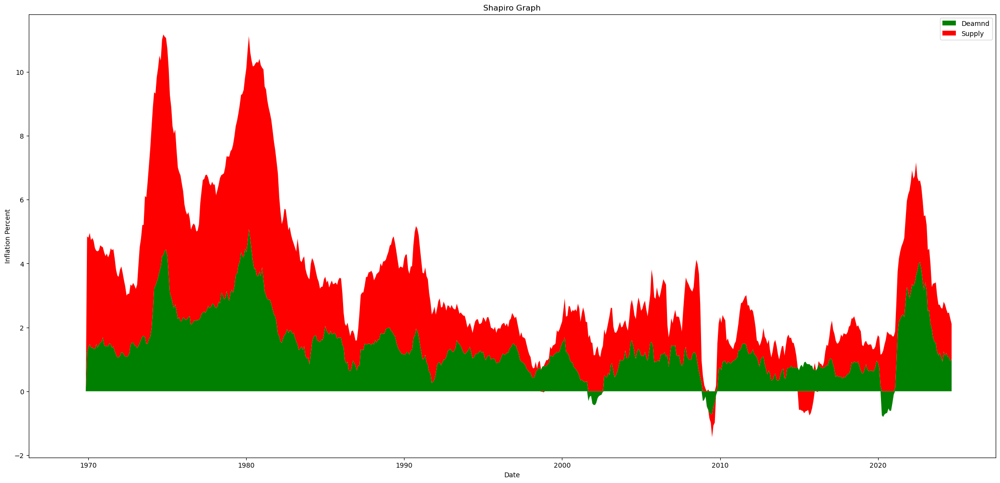

In [28]:
shapiro_graph = plot_shapiro_graph_from_shapiro_ouput(shapiro_code_output, "Shapiro Graph")

In [29]:
bea_quantities = pd.read_excel(os.path.join(raw_data_path, 'BEA Monthly Quantities.xlsx'))
bea_quantities = clean_bea_PQE_table(bea_quantities, "Quantities", long=True)
bea_quantities = bea_quantities[bea_quantities['products'].isin(gamma.index)]
bea_quantities = bea_quantities.drop_duplicates()
bea_quantities['Quantities'] = bea_quantities['Quantities'].replace('---', 0).astype(float)
bea_quantities = bea_quantities.fillna(0)

bea_prices = pd.read_excel(os.path.join(raw_data_path, 'BEA Monthly Prices.xlsx'))
bea_prices = clean_bea_PQE_table(bea_prices, "Prices", long=True)
bea_prices = bea_prices[bea_prices['products'].isin(gamma.index)]
bea_prices = bea_prices.drop_duplicates()
bea_prices['Prices'] = bea_prices['Prices'].replace('---', 0).astype(float)
bea_prices = bea_prices.fillna(0)

bea_expenditures = pd.read_excel(os.path.join(raw_data_path, 'BEA Monthly Expenditures.xlsx'))
bea_expenditures = clean_bea_PQE_table(bea_expenditures, "Expenditures", long=True)
bea_expenditures = bea_expenditures[bea_expenditures['products'].isin(gamma.index)]
bea_expenditures = bea_expenditures.drop_duplicates()
bea_expenditures['Expenditures'] = bea_expenditures['Expenditures'].replace('---', 0).astype(float)
bea_expenditures = bea_expenditures.fillna(0)

bea_PQE_merged = pd.merge(left=bea_quantities, right=bea_prices, on=['products', 'date'], how='outer')
bea_PQE_merged = pd.merge(left=bea_PQE_merged, right=bea_expenditures, on=['products', 'date'], how='outer')
bea_PQE_merged = bea_PQE_merged.fillna(0)

dates = list(set(bea_expenditures["date"]) & set(bea_prices["date"]) & set(bea_quantities["date"]))
dates.sort()

/var/folders/bs/21p_36y97dqfc1wddk8jv1vw0000gn/T/ipykernel_25650/2557053183.py:5: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  bea_quantities['Quantities'] = bea_quantities['Quantities'].replace('---', 0).astype(float)
/var/folders/bs/21p_36y97dqfc1wddk8jv1vw0000gn/T/ipykernel_25650/2557053183.py:6: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  bea_quantities = bea_quantities.fillna(0)
/var/folders/bs/21p_36y97dqfc1wddk8jv1vw0000gn/T/ipykernel_25650/2557053183.py:12: FutureWarning: Downcasting behavior in `replace` is deprecated and will be 

In [30]:
# total_dates = bea_PQE_merged['date'].nunique()
# product_dates_count1 = bea_PQE_merged[~((bea_PQE_merged['Quantities'] == 0) | (bea_PQE_merged['Prices'] == 0) | (bea_PQE_merged['Expenditures'] == 0))].groupby('products')['date'].nunique()
# product_dates_count = bea_PQE_merged.groupby('products')['date'].nunique()
# products_appear_all_dates = product_dates_count[product_dates_count == total_dates].index.tolist()
# len(products_appear_all_dates)

In [31]:
# bea_PQE_merged = bea_PQE_merged[bea_PQE_merged['products'].isin(products_appear_all_dates)]
# bea_expenditures = bea_expenditures[bea_expenditures['products'].isin(products_appear_all_dates)]
# bea_prices = bea_prices[bea_prices['products'].isin(products_appear_all_dates)]
# bea_quantities = bea_quantities[bea_quantities['products'].isin(products_appear_all_dates)]

# gamma =  gamma[gamma.index.isin(products_appear_all_dates)]
# omega = omega.loc[omega.index.intersection(products_appear_all_dates), omega.columns.intersection(products_appear_all_dates)]
# omega

In [32]:
# calculate sales in product and time period
sales = pd.DataFrame({'date': pd.Series(dtype='datetime64[ns]'),
                   'products': pd.Series(dtype='str'),
                   'sales': pd.Series(dtype='float')})

for date in dates:
    # filter expenditures for the current date
    expenditures_date = bea_expenditures[bea_expenditures['date'] == date][['products', 'Expenditures']].set_index('products')
    expenditures_date = expenditures_date.sort_index()
    expenditures_date = expenditures_date.apply(pd.to_numeric, errors='coerce')

    gamma_series = gamma["Row_Sum"]
    diag_matrix = np.diag(gamma_series)

    x = np.identity(len(omega)) - (omega.T @ diag_matrix)
    sales_date = np.linalg.inv(x) @ expenditures_date


    sales_date['date'] = date
    sales_date['products'] = expenditures_date.index
    sales_date.rename(columns={'Expenditures': 'sales'}, inplace=True)

    sales = pd.concat([sales, sales_date], ignore_index=True)

sales

,date,products,sales
0,1959-01-01,accessories and parts,4166.627593
1,1959-01-01,air transportation,638.774972
2,1959-01-01,alcohol in purchased meals,4834.858183
3,1959-01-01,all other professional medical services,74.802372
4,1959-01-01,"amusement parks, campgrounds, and related recr...",1214.604625
...,...,...,...
165685,2024-09-01,water transportation,26507.085845
165686,2024-09-01,window coverings,36362.081063
165687,2024-09-01,wine,80284.893106
165688,2024-09-01,women's and girls' clothing,250274.877826


# Some prices are zero, so log(0) gives -inf. I am manualling chaning -inf to 0. 

In [33]:
# calculate prices of intermediates (we use cobb douglas production with intermediates)
intermediates = pd.DataFrame({'date': pd.Series(dtype='datetime64[ns]'),
                   'products': pd.Series(dtype='str'),
                   'intermediates': pd.Series(dtype='float')})
for date in dates:
    prices_date = bea_prices[bea_prices['date'] == date][['products', 'Prices']].set_index('products')
    prices_date = prices_date.sort_index()
    
    for i in gamma.index:
        log_prices = np.log(prices_date['Prices'])
        log_prices.replace(-np.inf, 0, inplace=True)        
        intermediates.loc[len(intermediates)] = [date, i, np.exp(omega.loc[i] @ log_prices)]

/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, me

In [34]:
# calculate prices of value added
value_added = pd.DataFrame({'date': pd.Series(dtype='datetime64[ns]'),
                   'products': pd.Series(dtype='str'),
                   'value_added': pd.Series(dtype='float')})
for date in dates:
    # filter prices for the current date
    prices_date = bea_prices[bea_prices['date'] == date][['products', 'Prices']].set_index('products')
    prices_date = prices_date.sort_index()

    # filter intermediates for the current date
    intermediates_date = intermediates[intermediates['date'] == date][['products', 'intermediates']].set_index('products')
    intermediates_date = intermediates_date.sort_index()
    gamma_series = gamma["Row_Sum"]

    value_added_date = np.exp((1/(1 - gamma_series.sort_index()))*(np.log(prices_date['Prices']) - gamma_series.sort_index() * np.log(intermediates_date['intermediates'])))

    value_added_date = value_added_date.reset_index().rename(columns={0: 'value_added'})
    value_added_date['date'] = date
    value_added_date.rename(columns={"index": "products"}, inplace=True)

    value_added = pd.concat([value_added, value_added_date], ignore_index=True)

value_added

/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, me

/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, me

,date,products,value_added
0,1959-01-01,accessories and parts,39.636163
1,1959-01-01,air transportation,19.202113
2,1959-01-01,alcohol in purchased meals,8.790927
3,1959-01-01,all other professional medical services,0.000000
4,1959-01-01,"amusement parks, campgrounds, and related recr...",12.275218
...,...,...,...
165685,2024-09-01,water transportation,93.258790
165686,2024-09-01,window coverings,110.943621
165687,2024-09-01,wine,96.789142
165688,2024-09-01,women's and girls' clothing,99.844306


In [37]:
calculated = pd.merge(left=value_added, right=sales, on=['products', 'date'], how='inner')
original = bea_PQE_merged[bea_PQE_merged['products'] == product][['date', 'Prices', 'Quantities']].sort_values(['date'])
original

,date,Prices,Quantities
2370,1959-01-01,0.000,0.000
2371,1959-02-01,0.000,0.000
2372,1959-03-01,0.000,0.000
2373,1959-04-01,0.000,0.000
2374,1959-05-01,0.000,0.000
...,...,...,...
3155,2024-06-01,110.209,142.226
3156,2024-07-01,110.332,143.068
3157,2024-08-01,110.279,144.368
3158,2024-09-01,111.982,145.806


In [46]:
lags = 12
residuals = pd.DataFrame(columns=['date', 'products', 'residual_prices', 'residual_quantities', 'residual_value_added', 'residual_sales'])

for product in gamma.index:
    # filter for product
    original = bea_PQE_merged[bea_PQE_merged['products'] == product][['date', 'Prices', 'Quantities']].sort_values(['date'])
    calculated = pd.merge(left=value_added, right=sales, on=['products', 'date'], how='inner')
    calculated = calculated[calculated['products'] == product][['date', 'value_added', 'sales']].sort_values(['date'])
    # datetimeindex
    original = original.set_index('date')
    calculated = calculated.set_index('date')

    # using first differences
    original['Prices'] = np.log(original['Prices']).diff()
    original['Quantities'] = np.log(original['Quantities']).diff()

    original.replace([np.inf, -np.inf], np.nan, inplace=True)

    calculated['value_added'] = np.log(calculated['value_added']).diff()
    calculated['sales'] = np.log(calculated['sales']).diff()

    # drop nans for model
    # original = original[(original != 0).all(axis=1)]
    # calculated = calculated[(calculated != 0).all(axis=1)]
    # original.replace([np.inf, -np.inf], np.nan, inplace=True)
    calculated.replace([np.inf, -np.inf], np.nan, inplace=True)

    original.dropna(inplace=True)
    calculated.dropna(inplace=True)

    # Rebuild complete monthly index
    full_index = pd.date_range(start=original.index.min(), end=original.index.max(), freq='MS')
    original = original.reindex(full_index)
    original.dropna(inplace=True)

    # fit
    model_original = VAR(original)
    result_original = model_original.fit(lags)

    full_index_calc = pd.date_range(start=calculated.index.min(), end=calculated.index.max(), freq='MS')
    calculated = calculated.reindex(full_index_calc)
    calculated.dropna(inplace=True)

    model_calculated = VAR(calculated)
    result_calculated = model_calculated.fit(lags)

    residuals_original = result_original.resid.reset_index()
    residuals_original['products'] = product
    residuals_original.rename(columns={'index': 'date', 'Prices': 'residual_prices', 'Quantities': 'residual_quantities'}, inplace=True)
    residuals = pd.merge(left=residuals, right=residuals_original, on=['date', 'products', 'residual_prices', 'residual_quantities'], how='outer')

    residuals_calculated = result_calculated.resid.reset_index()
    residuals_calculated['products'] = product
    residuals_calculated.rename(columns={"index": "date", 'value_added': 'residual_value_added', 'sales': 'residual_sales'}, inplace=True)
    residuals = pd.merge(left=residuals, right=residuals_calculated, on=['date', 'products', 'residual_value_added', 'residual_sales'], how='outer')


residuals = residuals.groupby(['date', 'products']).sum(min_count=1).reset_index()
residuals = residuals.sort_values(['date', 'products'])

/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/BofC_shocks_production/lib/python3.13/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, me

In [47]:
residuals

,date,products,residual_prices,residual_quantities,residual_value_added,residual_sales
0,1960-02-01,accessories and parts,-0.007249,0.001144,-0.008916,0.029839
1,1960-02-01,air transportation,0.003598,-0.017578,0.004496,-0.011121
2,1960-02-01,alcohol in purchased meals,0.001063,-0.014381,0.003434,-0.011063
3,1960-02-01,"amusement parks, campgrounds, and related recr...",-0.004209,0.009296,-0.003063,0.004649
4,1960-02-01,"audio discs, tapes, vinyl, and permanent digit...",0.006907,0.007814,0.01067,0.016558
...,...,...,...,...,...,...
152785,2024-09-01,water transportation,-0.017831,0.008757,-0.020633,0.007495
152786,2024-09-01,window coverings,-0.008562,0.021818,-0.008924,-0.009076
152787,2024-09-01,wine,0.000641,0.002558,0.00246,0.000603
152788,2024-09-01,women's and girls' clothing,0.002642,-0.010582,0.003117,-0.003197


In [48]:
# classifications
# supply vs demand driven
residuals['majority_demand'] = ((residuals['residual_prices'] * residuals['residual_quantities']) >= 0).astype(int)
residuals['majority_supply'] = ((residuals['residual_prices'] * residuals['residual_quantities']) < 0).astype(int)
# further types of shocks
residuals['type'] = 'negative_supply'
residuals.loc[(residuals['residual_prices'] >= 0) & (residuals['residual_quantities'] < 0), 'type'] = 'positive_supply'
residuals.loc[(residuals['residual_prices'] >= 0) & (residuals['residual_quantities'] >= 0), 'type'] = 'positive_demand'
residuals.loc[(residuals['residual_prices'] < 0) & (residuals['residual_quantities'] < 0), 'type'] = 'negative_demand'

# supply vs demand driven
residuals['majority_demand_a'] = ((residuals['residual_value_added'] * residuals['residual_sales']) >= 0).astype(int)
residuals['majority_supply_a'] = ((residuals['residual_value_added'] * residuals['residual_sales']) < 0).astype(int)
# further types of shocks
residuals['type_a'] = 'negative_supply'
residuals.loc[(residuals['residual_value_added'] >= 0) & (residuals['residual_sales'] < 0), 'type_a'] = 'positive_supply'
residuals.loc[(residuals['residual_value_added'] >= 0) & (residuals['residual_sales'] >= 0), 'type_a'] = 'positive_demand'
residuals.loc[(residuals['residual_value_added'] < 0) & (residuals['residual_sales'] < 0), 'type_a'] = 'negative_demand'

In [49]:
residuals

,date,products,residual_prices,residual_quantities,residual_value_added,residual_sales,majority_demand,majority_supply,type,majority_demand_a,majority_supply_a,type_a
0,1960-02-01,accessories and parts,-0.007249,0.001144,-0.008916,0.029839,0,1,negative_supply,0,1,negative_supply
1,1960-02-01,air transportation,0.003598,-0.017578,0.004496,-0.011121,0,1,positive_supply,0,1,positive_supply
2,1960-02-01,alcohol in purchased meals,0.001063,-0.014381,0.003434,-0.011063,0,1,positive_supply,0,1,positive_supply
3,1960-02-01,"amusement parks, campgrounds, and related recr...",-0.004209,0.009296,-0.003063,0.004649,0,1,negative_supply,0,1,negative_supply
4,1960-02-01,"audio discs, tapes, vinyl, and permanent digit...",0.006907,0.007814,0.01067,0.016558,1,0,positive_demand,1,0,positive_demand
...,...,...,...,...,...,...,...,...,...,...,...,...
152785,2024-09-01,water transportation,-0.017831,0.008757,-0.020633,0.007495,0,1,negative_supply,0,1,negative_supply
152786,2024-09-01,window coverings,-0.008562,0.021818,-0.008924,-0.009076,0,1,negative_supply,1,0,negative_demand
152787,2024-09-01,wine,0.000641,0.002558,0.00246,0.000603,1,0,positive_demand,1,0,positive_demand
152788,2024-09-01,women's and girls' clothing,0.002642,-0.010582,0.003117,-0.003197,0,1,positive_supply,0,1,positive_supply


In [50]:
D = residuals.pivot(index='products', columns='date', values='majority_demand_a')
a = residuals.pivot(index='products', columns='date', values='majority_demand')
D

date,1960-02-01,1960-03-01,1960-04-01,1960-05-01,1960-06-01,1960-07-01,1960-08-01,1960-09-01,1960-10-01,1960-11-01,...,2023-12-01,2024-01-01,2024-02-01,2024-03-01,2024-04-01,2024-05-01,2024-06-01,2024-07-01,2024-08-01,2024-09-01
products,,,,,,,,,,,,,,,,,,,,,
accessories and parts,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,...,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0
air transportation,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
alcohol in purchased meals,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,...,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
all other professional medical services,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0
"amusement parks, campgrounds, and related recreational services",0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,...,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
water transportation,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
window coverings,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,...,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0
wine,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
D


date,1960-02-01,1960-03-01,1960-04-01,1960-05-01,1960-06-01,1960-07-01,1960-08-01,1960-09-01,1960-10-01,1960-11-01,...,2023-12-01,2024-01-01,2024-02-01,2024-03-01,2024-04-01,2024-05-01,2024-06-01,2024-07-01,2024-08-01,2024-09-01
products,,,,,,,,,,,,,,,,,,,,,
accessories and parts,0,0,0,1,0,0,1,1,0,1,...,1,0,1,1,1,1,1,1,0,1
air transportation,0,1,1,0,0,1,0,1,1,1,...,1,0,0,0,1,0,1,0,0,1
alcohol in purchased meals,0,0,0,1,1,1,1,0,1,0,...,1,1,1,0,0,1,1,0,0,0
"amusement parks, campgrounds, and related recreational services",0,0,1,1,0,0,0,1,1,1,...,1,0,0,0,1,1,1,1,1,1
"audio discs, tapes, vinyl, and permanent digital downloads",1,1,1,1,0,0,1,1,1,1,...,1,0,0,0,1,1,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
water transportation,0,1,1,0,1,0,1,1,0,1,...,0,1,1,1,1,0,1,1,0,0
window coverings,0,0,1,0,1,0,0,0,1,1,...,1,1,1,1,0,1,1,0,0,1
wine,0,0,0,0,1,0,0,0,0,0,...,1,0,0,0,1,0,0,0,0,1


In [ ]:
product_master = pd.read_excel('/Users/tonygui/Documents/Bank of Canada/shocks_productionnetworks/Product Master.xlsx')


In [ ]:
product_master = product_master[["Prodcuts in PCE Concordance"]]
product_master = product_master.dropna()
product_master

,Prodcuts in PCE Concordance
5,New domestic autos
6,New foreign autos
7,New light trucks
11,Used autos
15,Used light trucks
...,...
333,Passenger fares for foreign travel
334,U.S. travel outside the United States
335,U.S. student expenditures
336,Less: Expenditures in the United States by non...


In [ ]:
missing = set(product_master["Prodcuts in PCE Concordance"].str.lower()) - set(products_210) 


In [ ]:
missing

{'community food and housing/emergency/other relief services',
 'first-class postal service',
 'food furnished to employees',
 'fruit',
 "government employees' expenditures abroad",
 'other delivery services',
 "private employees' expenditures abroad",
 'u.s. student expenditures',
 'u.s. travel outside the united states',
 'vegetables'}

In [ ]:
products_210
products_210 = pd.DataFrame(products_210, columns=['col_name'])

In [ ]:
products_210

,col_name
0,accessories and parts
1,air transportation
2,alcohol in purchased meals
3,all other professional medical services
4,"amusement parks, campgrounds, and related recr..."
...,...
205,water transportation
206,window coverings
207,wine
208,women's and girls' clothing
